## Importing Modules

In [1]:
%load_ext autoreload
%autoreload 2
import os, sys
sys.path.append('/home/junhokang/script')
import scjp

2022-01-19 08:50:35.010917: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-01-19 08:50:35.010952: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
import numpy as np
import scipy as scipy
import scanpy as sc
import scanpy.external as sce
import pandas as pd
pd.set_option('display.max_rows', 40)
pd.set_option('display.max_columns', None)
import pickle as pkl
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [10,8]
import seaborn as sns
from collections import defaultdict, Counter
import networkx as nx
import igraph, re, glob
from bbknn import bbknn
from geosketch import gs
import scrublet as scr
import joblib as jl
from datetime import datetime
def timestamp():
    return datetime.now().strftime("%y%m%d%H%M")
import logging
import scipy.stats
import diffxpy.api as de
from SCCAF import *
import gseapy
import scvelo as scv
import cellrank as cr

In [3]:
# setting scanpy
%matplotlib inline
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, color_map='OrRd')
sc.logging.print_version_and_date()

Running Scanpy 1.8.1, on 2022-01-19 08:50.


In [4]:
nb_name = 'MOG15.v03.MOG3_Figure_211208'
version = '.'.join(nb_name.split('.')[:2])+'.'
data = '_'.join(nb_name.split('.')[-1:][0].split('_')[:-1])
print('Version:', version)
print('Data:', data)

Version: MOG15.v03.
Data: MOG3_Figure


In [5]:
base_folder = '/home/junhokang/projects/02_mogad_new/'

## Loading Adata

In [6]:
adata = sc.read('./write/MOG15.v02.MOG_10X3_reanno_211123.h5ad')

Only considering the two last: ['.MOG_10X3_reanno_211123', '.h5ad'].
Only considering the two last: ['.MOG_10X3_reanno_211123', '.h5ad'].


In [7]:
adata

AnnData object with n_obs × n_vars = 135234 × 4648
    obs: 'Sample', 'PatientID', 'DiseaseCode', 'Diagnosis', 'Tissue', 'Disease', 'Myelin', 'Antibody', 'Gender', 'Source', 'Chemistry', 'dzcode', 'anno_final_211110', 'n_counts', 'n_genes', 'mito', 'doublet_scores', 'predicted_doublets', 'DiseaseState', 'Birth', 'Comorbidity', 'Current Tx', 'Recent attack', 'Sampling date', 'OpticNerve', 'Brain', 'SpinalCord', 'anno_predict', 'anno_sccaf', 'EDSS', 'CSF_lab', 'CSF_oligoclonal_band', 'Serum_alb', 'Serum_IgG', 'CSF_alb', 'CSF_IgG', 'IgG_index', 'Height', 'Weight', 'BMI', 'Tchol-TG-HDL-LDL', 'Tchol', 'LDL', 'leiden', 'anno_final'
    var: 'gene_ids', 'feature_types', 'GeneName', 'EnsemblID', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PatientID_colors', 'anno_final_211110_colors', 'anno_final_colors', 'anno_sccaf_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sub_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umap_original'
    varm: 'PCs'
    obsp: 'conn

In [9]:
adata.obs['anno_final'].replace({'Myl_tDC':'Myl_ASDC'},inplace=True)
cat=list(sorted(set(adata.obs['anno_final'])))
adata.obs['anno_final']=adata.obs['anno_final'].cat.reorder_categories(cat)

In [14]:
adata.obs['DiseaseCode']=['MS' if 'AQP4-NMOSD' in x else x for x in adata.obs['DiseaseCode']]
adata.obs['DzCode']=['Ab-mediated IDD' if 'MO' in x else x for x in adata.obs['DiseaseCode']]

In [26]:
jp=sc.read('./jp_anno/MOG_JP_Final.scmgl_three.h5ad')

In [47]:
jp_anno={a:b for a,b in zip(jp.obs.index,jp.obs['anno_jp_final'])}

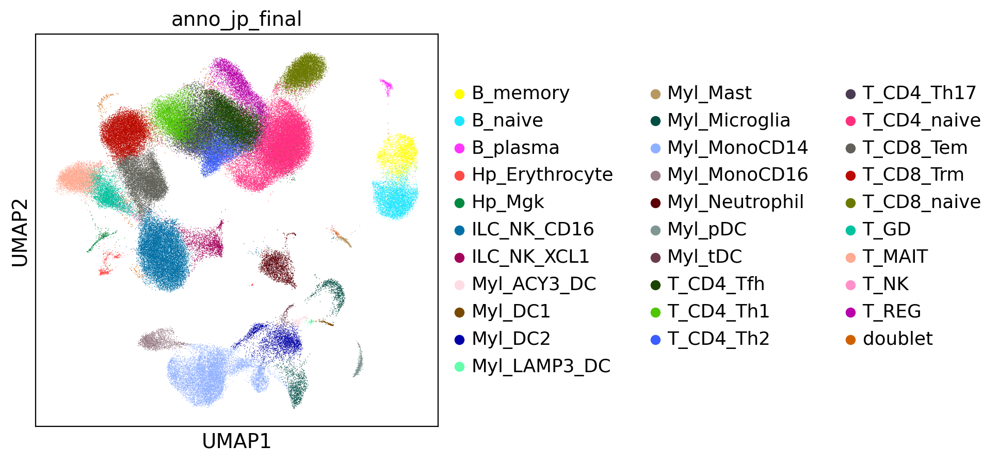

In [40]:
scjp.us(jp,'anno_jp_final')

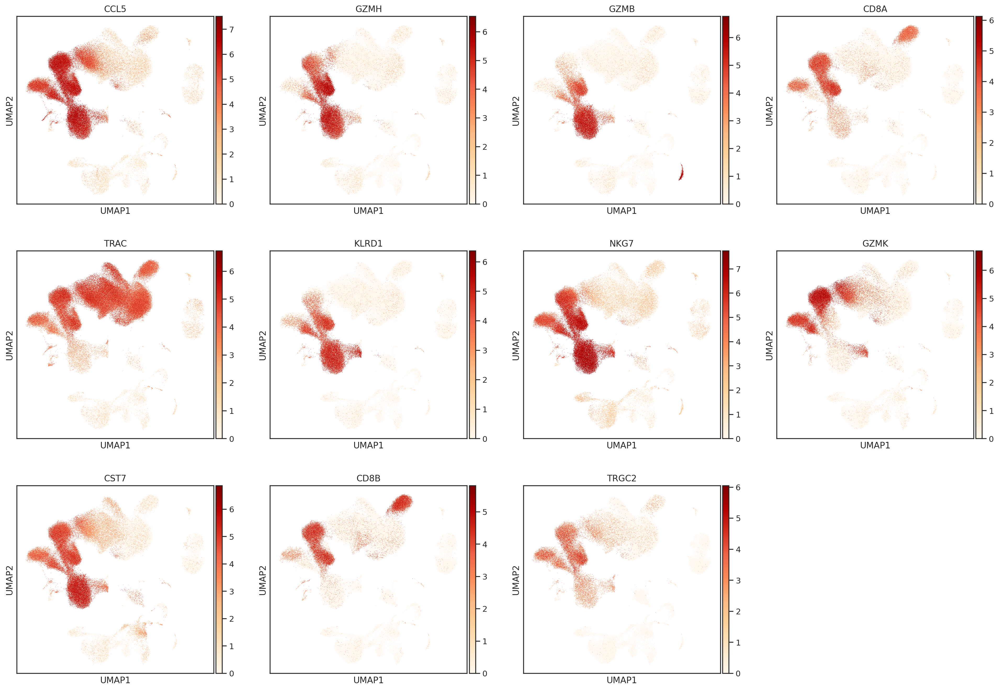

In [329]:
#Tem
scjp.us(adata,'CCL5,GZMH,GZMB,CD8A,TRAC,KLRD1,NKG7,GZMK,CST7,CD8B,TRGC2')

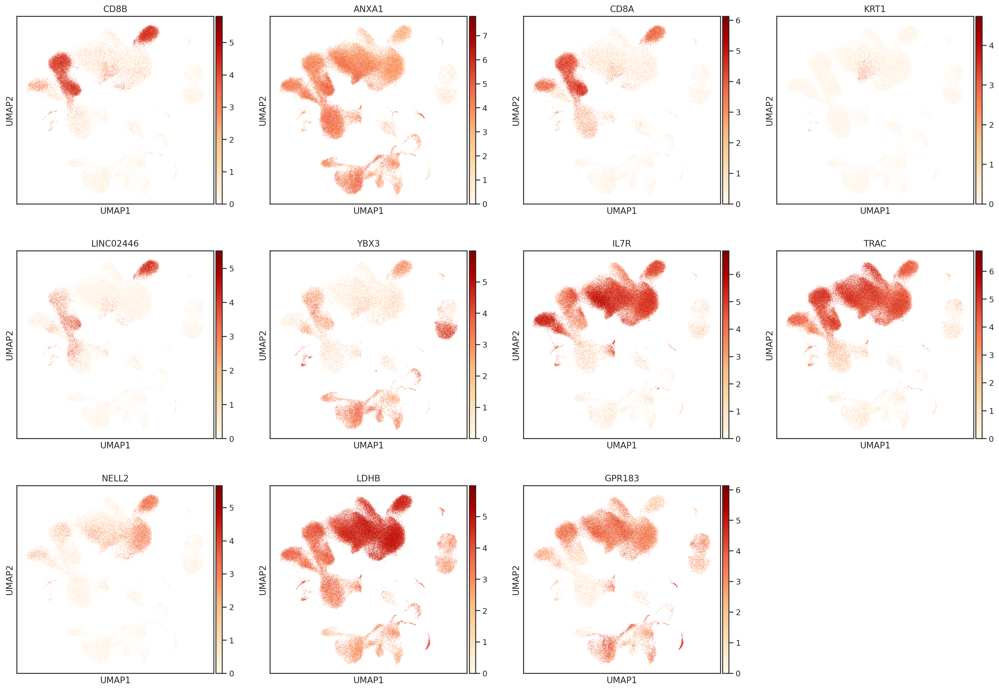

In [328]:
#Tcm
scjp.us(adata,'CD8B,ANXA1,CD8A,KRT1,LINC02446,YBX3,IL7R,TRAC,NELL2,LDHB,GPR183')

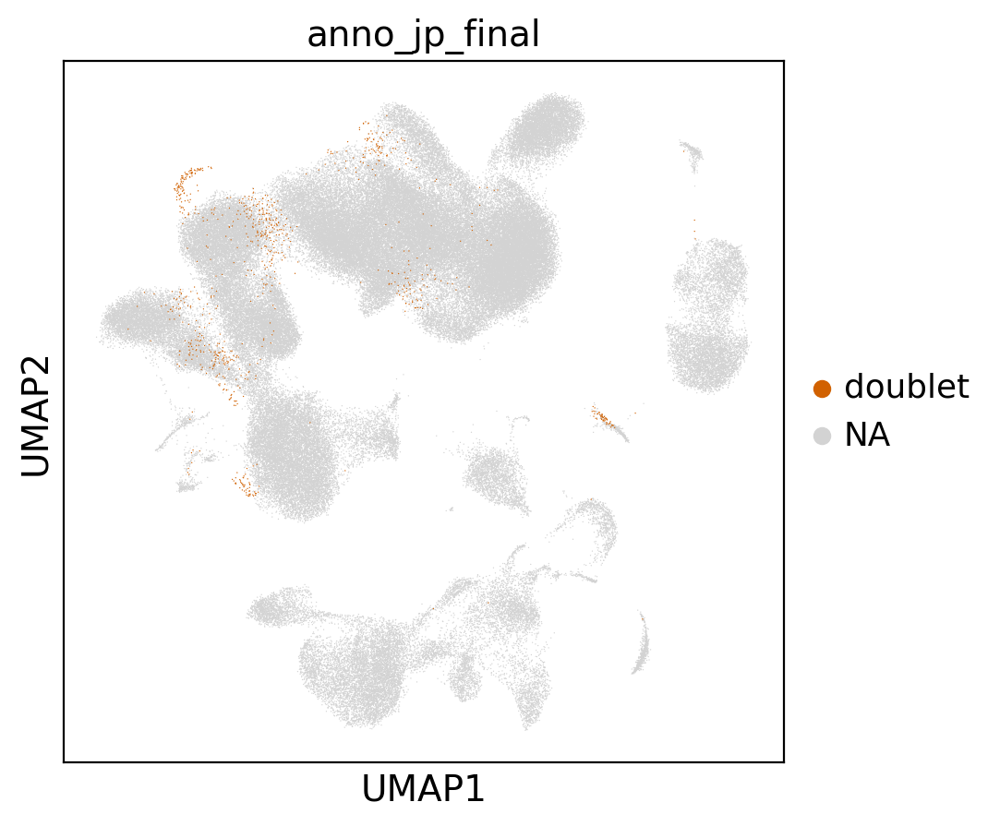

In [31]:
scjp.us(jp,'anno_jp_final',groups='doublet')

In [48]:
adata.obs['anno_jp_final'] = [jp_anno[x] for x in adata.obs.index]

In [55]:
ilc=adata.obs[adata.obs['anno_final']=='ILC'].index

In [60]:
adata.obs['anno_jp_final']=['ILC' if x in ilc else adata.obs.loc[x,'anno_jp_final'] for x in adata.obs.index]

... storing 'anno_jp_final' as categorical


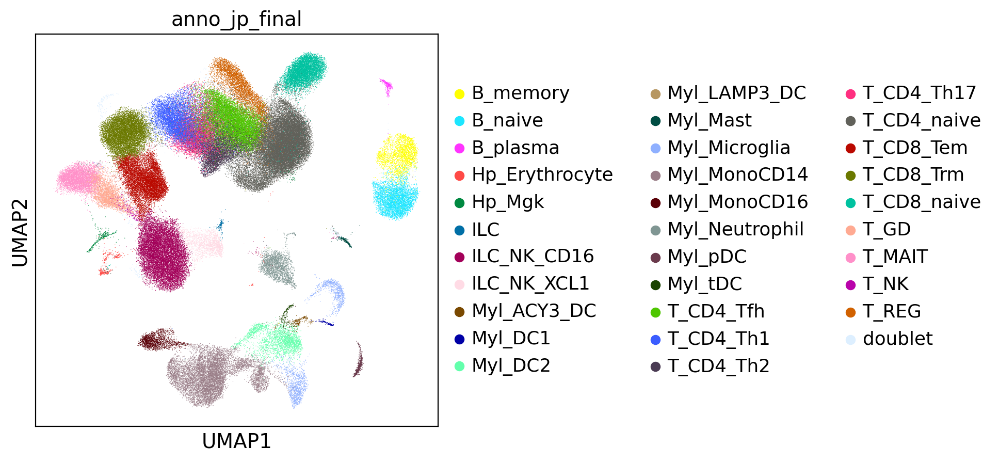

In [61]:
scjp.us(adata,'anno_jp_final')

In [63]:
adata.obs['anno_jp_final'].replace({'Myl_tDC':'Myl_ASDC'},inplace=True)
cat=list(sorted(set(adata.obs['anno_jp_final'])))
adata.obs['anno_jp_final']=adata.obs['anno_jp_final'].cat.reorder_categories(cat)

In [64]:
adata.write('./write/MOG15.v04.MOG_10X3_reanno_211228.h5ad')

In [73]:
adata=adata[adata.obs['anno_jp_final']!='doublet']

In [204]:
adata.write('./write/MOG15.v04.MOG_10X3_reanno_dbrm_211229.h5ad')

## Figure Generation

In [7]:
adata=sc.read('./write/MOG15.v04.MOG_10X3_reanno_dbrm_211229.h5ad')

Only considering the two last: ['.MOG_10X3_reanno_dbrm_211229', '.h5ad'].
Only considering the two last: ['.MOG_10X3_reanno_dbrm_211229', '.h5ad'].


In [65]:
adata

AnnData object with n_obs × n_vars = 134356 × 4648
    obs: 'Sample', 'PatientID', 'DiseaseCode', 'Diagnosis', 'Tissue', 'Disease', 'Myelin', 'Antibody', 'Gender', 'Source', 'Chemistry', 'anno_final_211110', 'n_counts', 'n_genes', 'mito', 'doublet_scores', 'predicted_doublets', 'DiseaseState', 'Birth', 'Comorbidity', 'Current Tx', 'Recent attack', 'Sampling date', 'OpticNerve', 'Brain', 'SpinalCord', 'anno_predict', 'anno_sccaf', 'EDSS', 'CSF_lab', 'CSF_oligoclonal_band', 'Serum_alb', 'Serum_IgG', 'CSF_alb', 'CSF_IgG', 'IgG_index', 'Height', 'Weight', 'BMI', 'Tchol-TG-HDL-LDL', 'Tchol', 'LDL', 'leiden', 'anno_final', 'DzCode', 'anno_jp_final', 'Dz', 'temp'
    var: 'gene_ids', 'feature_types', 'GeneName', 'EnsemblID', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PatientID_colors', 'Tissue_colors', 'anno_final_211110_colors', 'anno_final_colors', 'anno_jp_final_colors', 'anno_sccaf_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sub_colors', 'umap'
    ob

In [66]:
Counter(adata.obs['Tissue'])

Counter({'CSF': 41455, 'PBMC': 92901})

Trying to set attribute `.uns` of view, copying.


v2_figures/F1B.UMAP_all.pdf


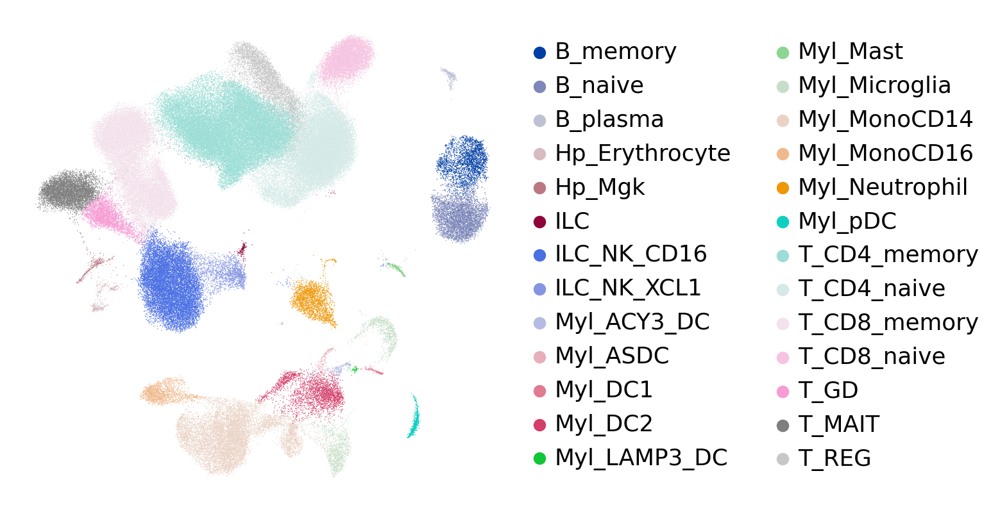

In [74]:
scjp.us(adata,'anno_final',frameon=False)
plt.title('')
scjp.save_fig('F1B.','UMAP_all',fig_folder='v2_figures')

In [451]:
color_total={a:b for a,b in zip (sorted(set(adata.obs['anno_jp_final'])),adata.uns['anno_jp_final_colors'])}

In [452]:
with open('./write/anno_jp_final_color_total.pkl', 'wb') as f:
    pkl.dump(color_total, f)

v2_figures/SF1A.UMAP_Tsub.pdf


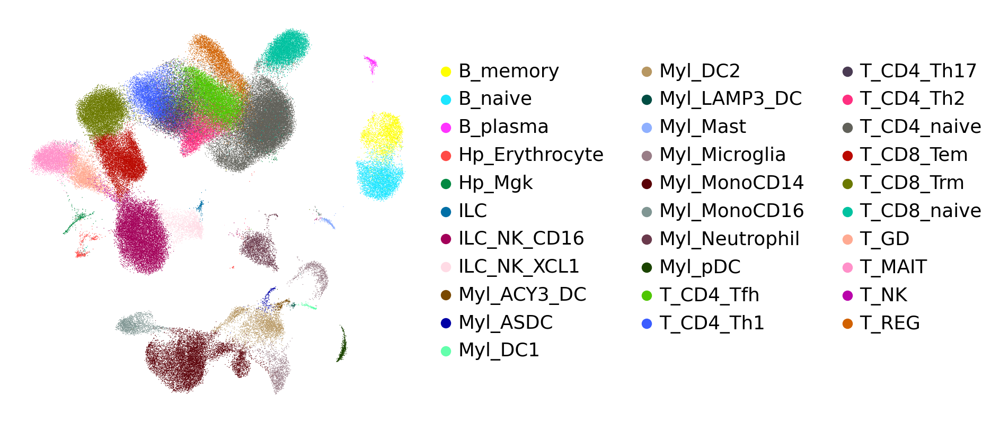

In [75]:
scjp.us(adata,'anno_jp_final',frameon=False)
plt.title('')
scjp.save_fig('SF1A.','UMAP_Tsub',fig_folder='v2_figures')

v2_figures/F1C.UMAP_tissue.pdf


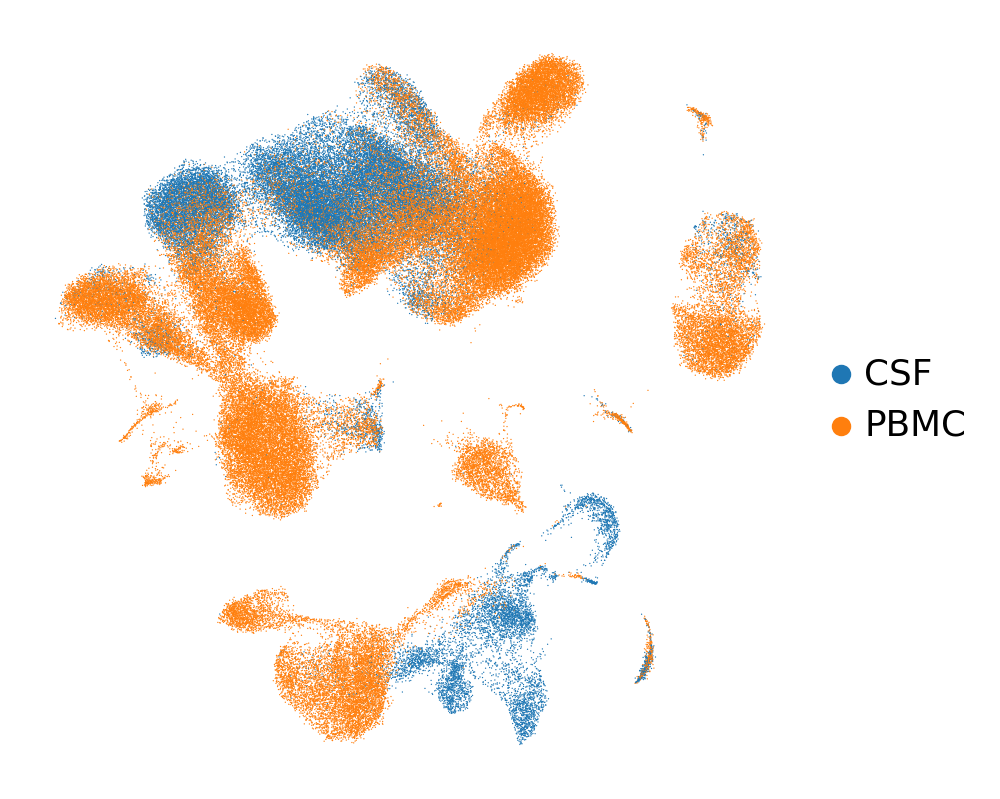

In [76]:
scjp.us(adata,'Tissue',frameon=False)
plt.title('')
scjp.save_fig('F1C.','UMAP_tissue',fig_folder='v2_figures')

In [51]:
myl = [x for x in set(adata.obs['anno_final']) if 'Myl_' in x]
mdata = scjp.get_subset(adata,adata.obs['anno_final'].isin(myl))

extracting highly variable genes
    finished (0:00:02)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
removing cc_genes...
computing PCA
    with n_comps=50
    finished (0:00:09)


In [52]:
scjp.run_harmony(mdata,'PatientID')

2022-01-20 06:51:56,141 - harmonypy - INFO - Iteration 1 of 10
2022-01-20 06:52:04,325 - harmonypy - INFO - Iteration 2 of 10
2022-01-20 06:52:12,105 - harmonypy - INFO - Iteration 3 of 10
2022-01-20 06:52:19,898 - harmonypy - INFO - Iteration 4 of 10
2022-01-20 06:52:27,875 - harmonypy - INFO - Iteration 5 of 10
2022-01-20 06:52:35,776 - harmonypy - INFO - Converged after 5 iterations


calculating neighbors...
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
calculating umap...
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


## MOG3 Myeloid UMAP

In [53]:
mdata

AnnData object with n_obs × n_vars = 19233 × 7285
    obs: 'Sample', 'PatientID', 'DiseaseCode', 'Diagnosis', 'Tissue', 'Disease', 'Myelin', 'Antibody', 'Gender', 'Source', 'Chemistry', 'anno_final_211110', 'n_counts', 'n_genes', 'mito', 'doublet_scores', 'predicted_doublets', 'DiseaseState', 'Birth', 'Comorbidity', 'Current Tx', 'Recent attack', 'Sampling date', 'OpticNerve', 'Brain', 'SpinalCord', 'anno_predict', 'anno_sccaf', 'EDSS', 'CSF_lab', 'CSF_oligoclonal_band', 'Serum_alb', 'Serum_IgG', 'CSF_alb', 'CSF_IgG', 'IgG_index', 'Height', 'Weight', 'BMI', 'Tchol-TG-HDL-LDL', 'Tchol', 'LDL', 'leiden', 'anno_final', 'DzCode', 'anno_jp_final', 'Dz', 'temp'
    var: 'gene_ids', 'feature_types', 'GeneName', 'EnsemblID', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_pca_before', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [54]:
Counter(mdata.obs['Tissue'])

Counter({'CSF': 6695, 'PBMC': 12538})

... storing 'Dz' as categorical
... storing 'temp' as categorical


Text(0.5, 1.0, '')

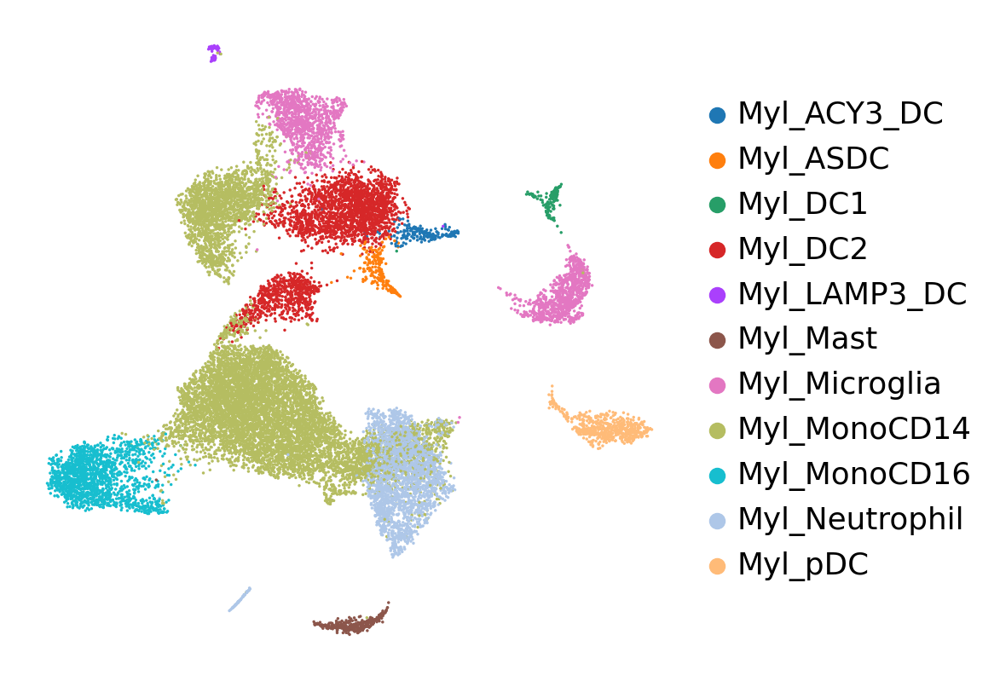

In [55]:
scjp.us(mdata,'anno_final',frameon=False)
plt.title('')
#scjp.save_fig('F2A.','UMAP_myeloid',fig_folder='v2_figures')

v2_figures/F2B.UMAP_myl_tissue.pdf


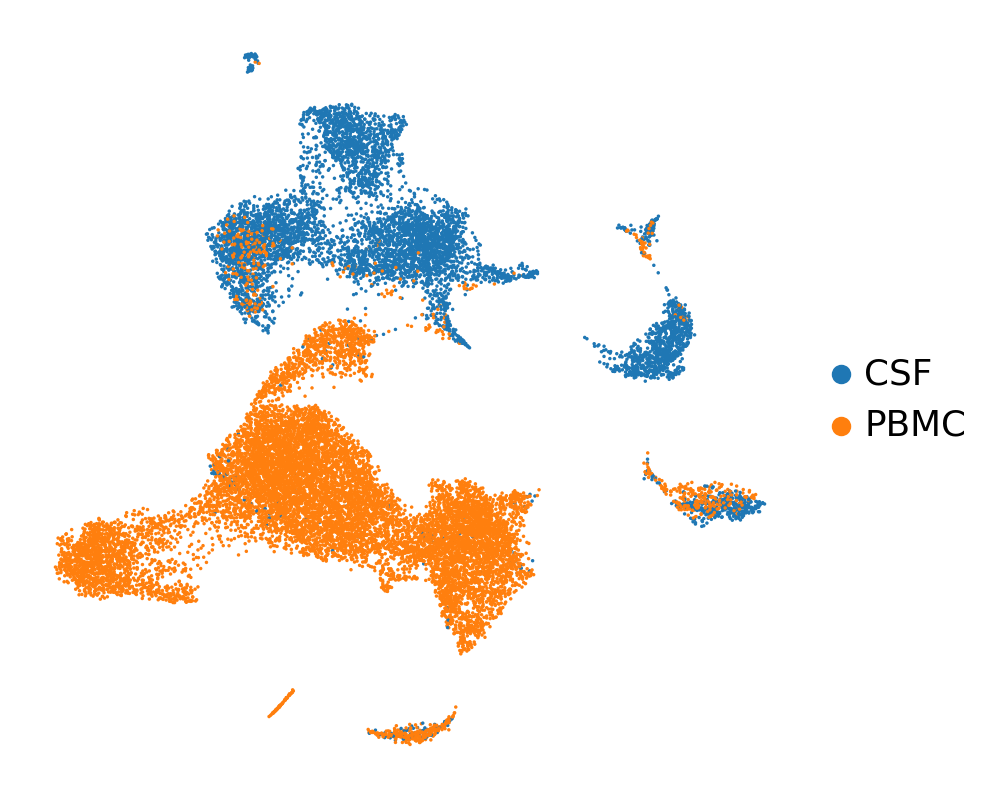

In [86]:
scjp.us(mdata,'Tissue',frameon=False)
plt.title('')
scjp.save_fig('F2B.','UMAP_myl_tissue',fig_folder='v2_figures')

v2_figures/F4.UMAP_TNFSF15_CSF.pdf


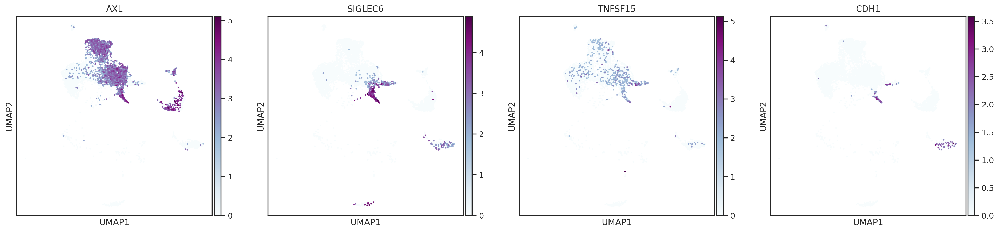

In [412]:
scjp.us(mdata[(mdata.obs['Tissue']=='CSF')],'AXL,SIGLEC6,TNFSF15,CDH1',cmap='BuPu')
scjp.save_fig('F4.','UMAP_TNFSF15_CSF',fig_folder='v2_figures')

v2_figures/F4.UMAP_TNFSF15_PBMC.pdf


<Figure size 900x600 with 0 Axes>

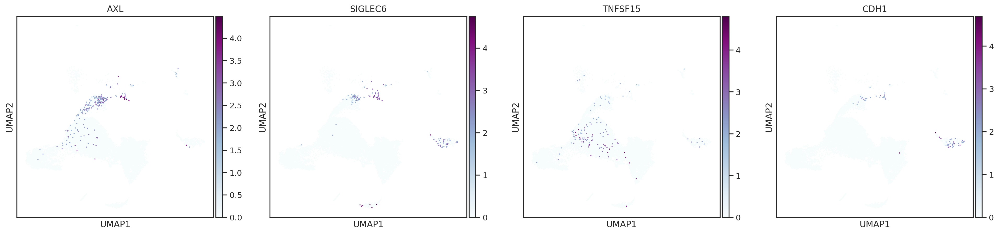

In [413]:
plt.figure(figsize=(9,6))
scjp.us(mdata[(mdata.obs['Tissue']=='PBMC')],'AXL,SIGLEC6,TNFSF15,CDH1',cmap='BuPu')
scjp.save_fig('F4.','UMAP_TNFSF15_PBMC',fig_folder='v2_figures')

### UMAP of DC

In [87]:
dc = [x for x in set(adata.obs['anno_final']) if 'DC' in x]
dccsf=scjp.get_subset(adata,(adata.obs['Tissue']=='CSF') & (adata.obs['anno_final'].isin(dc)))
scjp.run_harmony(dccsf,'PatientID',n_pcs=10)

extracting highly variable genes
    finished (0:00:01)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
removing cc_genes...
computing PCA
    with n_comps=50
    finished (0:00:10)


2021-12-29 11:46:56,597 - harmonypy - INFO - Iteration 1 of 10
2021-12-29 11:46:57,854 - harmonypy - INFO - Iteration 2 of 10
2021-12-29 11:47:00,075 - harmonypy - INFO - Iteration 3 of 10
2021-12-29 11:47:00,886 - harmonypy - INFO - Iteration 4 of 10
2021-12-29 11:47:01,849 - harmonypy - INFO - Iteration 5 of 10
2021-12-29 11:47:03,365 - harmonypy - INFO - Iteration 6 of 10
2021-12-29 11:47:04,953 - harmonypy - INFO - Iteration 7 of 10
2021-12-29 11:47:05,556 - harmonypy - INFO - Iteration 8 of 10
2021-12-29 11:47:06,197 - harmonypy - INFO - Iteration 9 of 10
2021-12-29 11:47:07,641 - harmonypy - INFO - Iteration 10 of 10
2021-12-29 11:47:08,890 - harmonypy - INFO - Stopped before convergence


calculating neighbors...
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
calculating umap...
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [88]:
dccsf

AnnData object with n_obs × n_vars = 2828 × 8919
    obs: 'Sample', 'PatientID', 'DiseaseCode', 'Diagnosis', 'Tissue', 'Disease', 'Myelin', 'Antibody', 'Gender', 'Source', 'Chemistry', 'anno_final_211110', 'n_counts', 'n_genes', 'mito', 'doublet_scores', 'predicted_doublets', 'DiseaseState', 'Birth', 'Comorbidity', 'Current Tx', 'Recent attack', 'Sampling date', 'OpticNerve', 'Brain', 'SpinalCord', 'anno_predict', 'anno_sccaf', 'EDSS', 'CSF_lab', 'CSF_oligoclonal_band', 'Serum_alb', 'Serum_IgG', 'CSF_alb', 'CSF_IgG', 'IgG_index', 'Height', 'Weight', 'BMI', 'Tchol-TG-HDL-LDL', 'Tchol', 'LDL', 'leiden', 'anno_final', 'DzCode', 'anno_jp_final'
    var: 'gene_ids', 'feature_types', 'GeneName', 'EnsemblID', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_pca_before', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [89]:
color={a:b for a,b in zip(sorted(set(mdata.obs['anno_final'])),mdata.uns['anno_final_colors'])}
dccolor=[color[x] for x in sorted(set(dccsf.obs['anno_final']))]

In [90]:
dccsf.uns['anno_final_colors']=dccolor

v2_figures/F3A.UMAP_DC.pdf


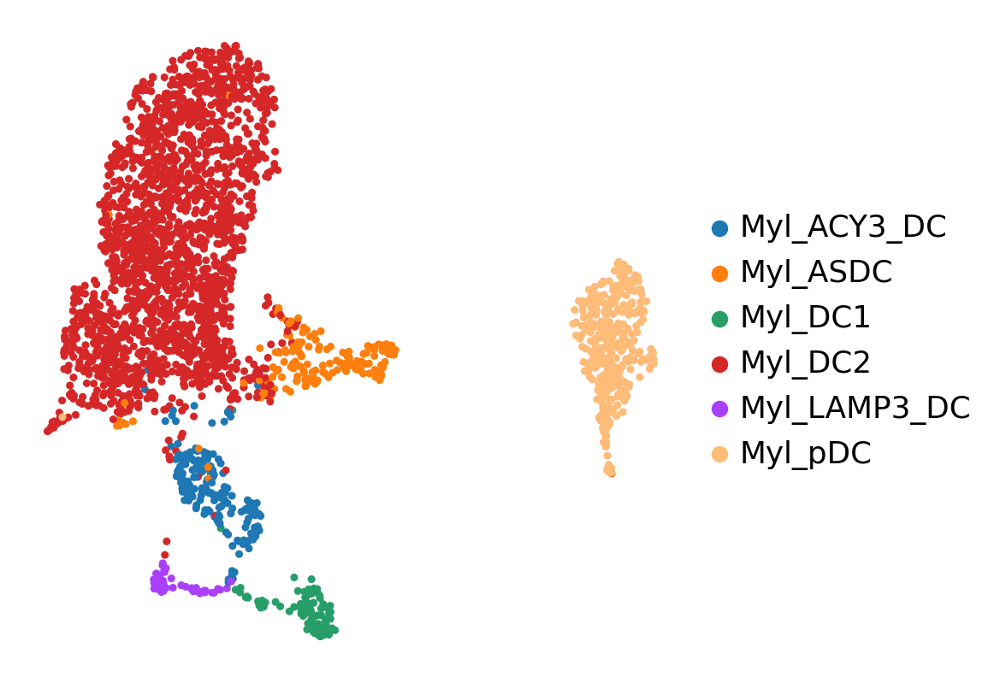

In [91]:
scjp.us(dccsf,'anno_final',frameon=False)
plt.title('')
scjp.save_fig('F3A.','UMAP_DC',fig_folder='v2_figures')

v2_figures/F3C.UMAP_asdc.pdf


<Figure size 900x600 with 0 Axes>

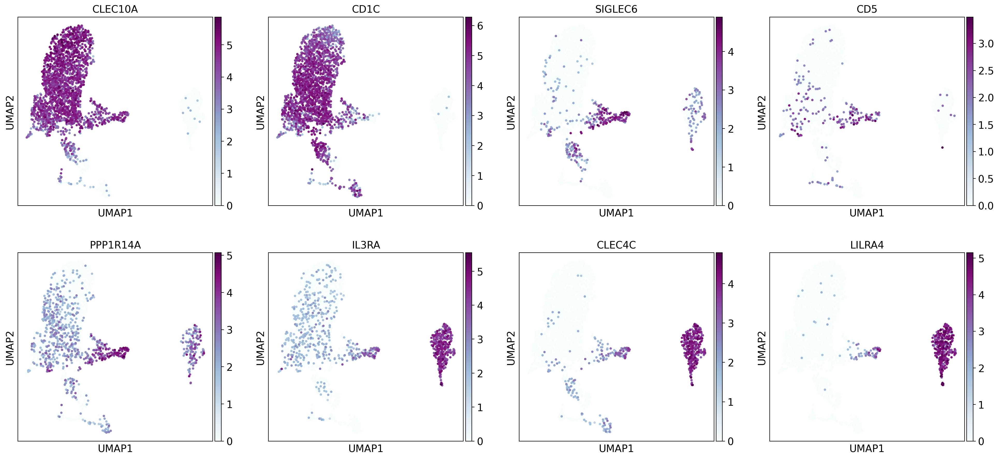

In [93]:
plt.figure(figsize=(9,6))
scjp.us(dccsf,'CLEC10A,CD1C,SIGLEC6,CD5,PPP1R14A,IL3RA,CLEC4C,LILRA4',cmap='BuPu')
scjp.save_fig('F3C.','UMAP_asdc',fig_folder='v2_figures')

v2_figures/F3C.UMAP_acy3.pdf


<Figure size 900x600 with 0 Axes>

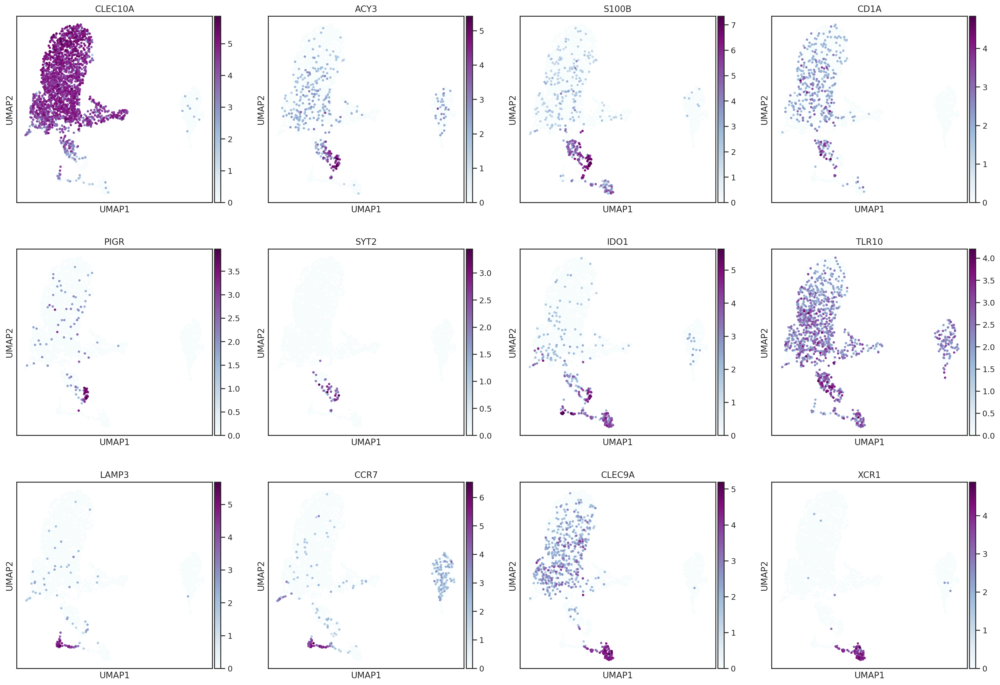

In [404]:
plt.figure(figsize=(9,6))
scjp.us(dccsf,'CLEC10A,ACY3,S100B,CD1A,PIGR,SYT2,IDO1,TLR10,LAMP3,CCR7,CLEC9A,XCR1',cmap='BuPu')
scjp.save_fig('F3C.','UMAP_acy3',fig_folder='v2_figures')

## Dotplot of DC

In [453]:
dc = [x for x in set(adata.obs['anno_final']) if 'DC' in x]
dcdata = adata[adata.obs['anno_final'].isin(dc)]

In [454]:
cdm_out = scjp.markers.calculate_markers(dcdata,'anno_final')
markers='ACY3,S100B,KIT,AHR,CD1A, ,CLEC9A,XCR1, ,CLEC10A,CD1C,FCER1A, ,AXL,SIGLEC6,PPP1R14A,ADAM33, ,IL3RA,CLEC4C,JCHAIN, ,LAMP3,CCR7'.split(',')
ctlist='Myl_ACY3_DC,Myl_DC1,Myl_DC2,Myl_ASDC,Myl_pDC,Myl_LAMP3_DC'.split(',')

v2_figures/F2C.Dotplot_dc.pdf


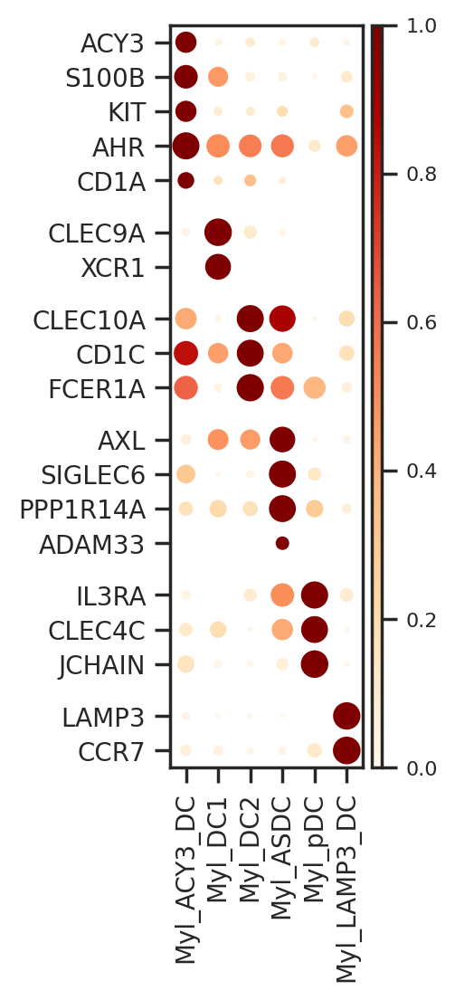

In [455]:
scjp.markers.draw_marker_blob_v2(dcdata,cdm_out,markers,ctlist=ctlist,show=False)
scjp.save_fig('F2C.','Dotplot_dc',fig_folder='v2_figures')

## MOG3 Dotplot of tsub

In [69]:
tsub = [x for x in set(adata.obs['anno_jp_final']) if 'T_CD4_' in x]
tsubdata = adata[adata.obs['anno_jp_final'].isin(tsub)]

In [70]:
tsub

['T_CD4_Th1', 'T_CD4_Tfh', 'T_CD4_naive', 'T_CD4_Th17', 'T_CD4_Th2']

In [71]:
cdm_out = scjp.markers.calculate_markers(tsubdata,'anno_jp_final')
markers='CXCR5,TIGIT,RORC,CISH,CCL5,TBX21,GATA3'.split(',')
ctlist='T_CD4_Tfh,T_CD4_Th17,T_CD4_Th1,T_CD4_Th2'.split(',')

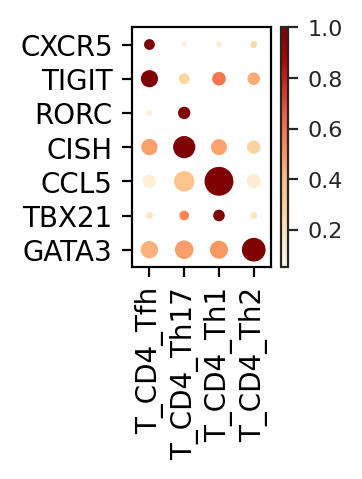

In [72]:
scjp.markers.draw_marker_blob_v2(tsubdata,cdm_out,markers,ctlist=ctlist,show=False)
#scjp.save_fig('F2C.','Dotplot_tsub',fig_folder='v2_figures')

### Pie Chart of DC proportion

In [103]:
dcdata

View of AnnData object with n_obs × n_vars = 3819 × 4648
    obs: 'Sample', 'PatientID', 'DiseaseCode', 'Diagnosis', 'Tissue', 'Disease', 'Myelin', 'Antibody', 'Gender', 'Source', 'Chemistry', 'anno_final_211110', 'n_counts', 'n_genes', 'mito', 'doublet_scores', 'predicted_doublets', 'DiseaseState', 'Birth', 'Comorbidity', 'Current Tx', 'Recent attack', 'Sampling date', 'OpticNerve', 'Brain', 'SpinalCord', 'anno_predict', 'anno_sccaf', 'EDSS', 'CSF_lab', 'CSF_oligoclonal_band', 'Serum_alb', 'Serum_IgG', 'CSF_alb', 'CSF_IgG', 'IgG_index', 'Height', 'Weight', 'BMI', 'Tchol-TG-HDL-LDL', 'Tchol', 'LDL', 'leiden', 'anno_final', 'DzCode', 'anno_jp_final'
    var: 'gene_ids', 'feature_types', 'GeneName', 'EnsemblID', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PatientID_colors', 'anno_final_211110_colors', 'anno_sccaf_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sub_colors', 'umap', 'Tissue_colors', 'anno_jp_final_colors', 'anno_final_colors'
    obsm: 'X_p

In [104]:
order=['Myl_ACY3_DC','Myl_ASDC','Myl_DC1', 'Myl_DC2','Myl_LAMP3_DC','Myl_pDC']
dcpie=pd.crosstab(dcdata.obs['Chemistry'],dcdata.obs['anno_final'], normalize=0)[order].T

In [105]:
data=list(dcpie.iloc[:,0])
labels=list(dcpie.index)
color={a:b for a,b in zip(sorted(set(mdata.obs['anno_final'])),mdata.uns['anno_final_colors'])}
dccolor=[color[x] for x in order]

/tmp/ipykernel_1799/3688348635.py:2: MatplotlibDeprecationWarning: normalize=None does not normalize if the sum is less than 1 but this behavior is deprecated since 3.3 until two minor releases later. After the deprecation period the default value will be normalize=True. To prevent normalization pass normalize=False 
  pie=plt.pie(data,labels=None,colors=dccolor,startangle=90,autopct='%1.1f%%',pctdistance=0.65,wedgeprops={'alpha':0.6})


v2_figures/F2D.Pie_dc.pdf


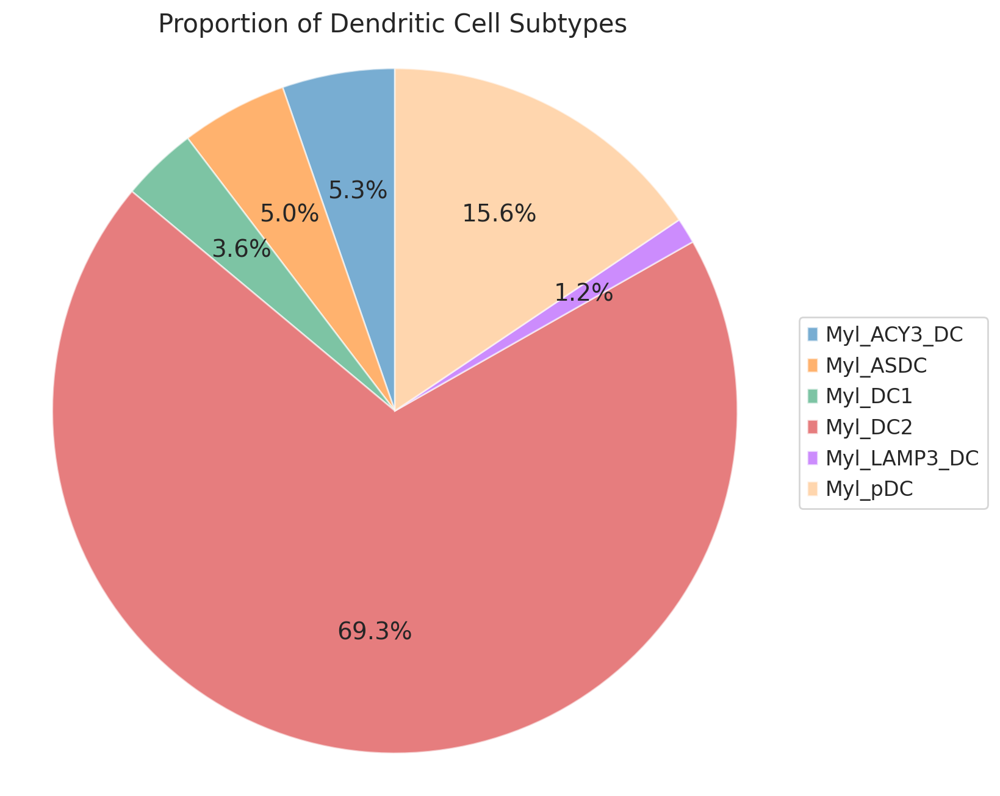

In [106]:
plt.figure(figsize=(8,8))
pie=plt.pie(data,labels=None,colors=dccolor,startangle=90,autopct='%1.1f%%',pctdistance=0.65,wedgeprops={'alpha':0.6})
plt.title('Proportion of Dendritic Cell Subtypes',fontsize=15)
plt.legend(labels,bbox_to_anchor=(1.02, 0.5),loc='center left',fontsize=12)
plt.axis('equal')
scjp.save_fig('F2D.','Pie_dc',fig_folder='v2_figures')
plt.show()

## Correlation Plot (Myeloid Cells)

In [107]:
mdraw=dcdata.raw.to_adata()
geneexp=pd.DataFrame(data=mdraw.X.toarray(),index=mdraw.obs['anno_final'],columns=mdraw.var_names)
geneexp = geneexp.groupby(geneexp.index).mean()

In [108]:
rm = []
for f in geneexp.columns:
    if np.max(geneexp[f])>1:
        continue
    else:
        rm.append(f)

In [109]:
len(rm)

32401

In [110]:
len(geneexp.columns)-len(rm)

4200

In [111]:
geneexp_slim = geneexp.drop(labels=rm,axis=1)

In [112]:
geneexp_slim = geneexp_slim.reindex(['Myl_DC1','Myl_ACY3_DC','Myl_DC2','Myl_ASDC','Myl_pDC','Myl_LAMP3_DC',])

v2_figures/SF1C.DC_heatmap.pdf


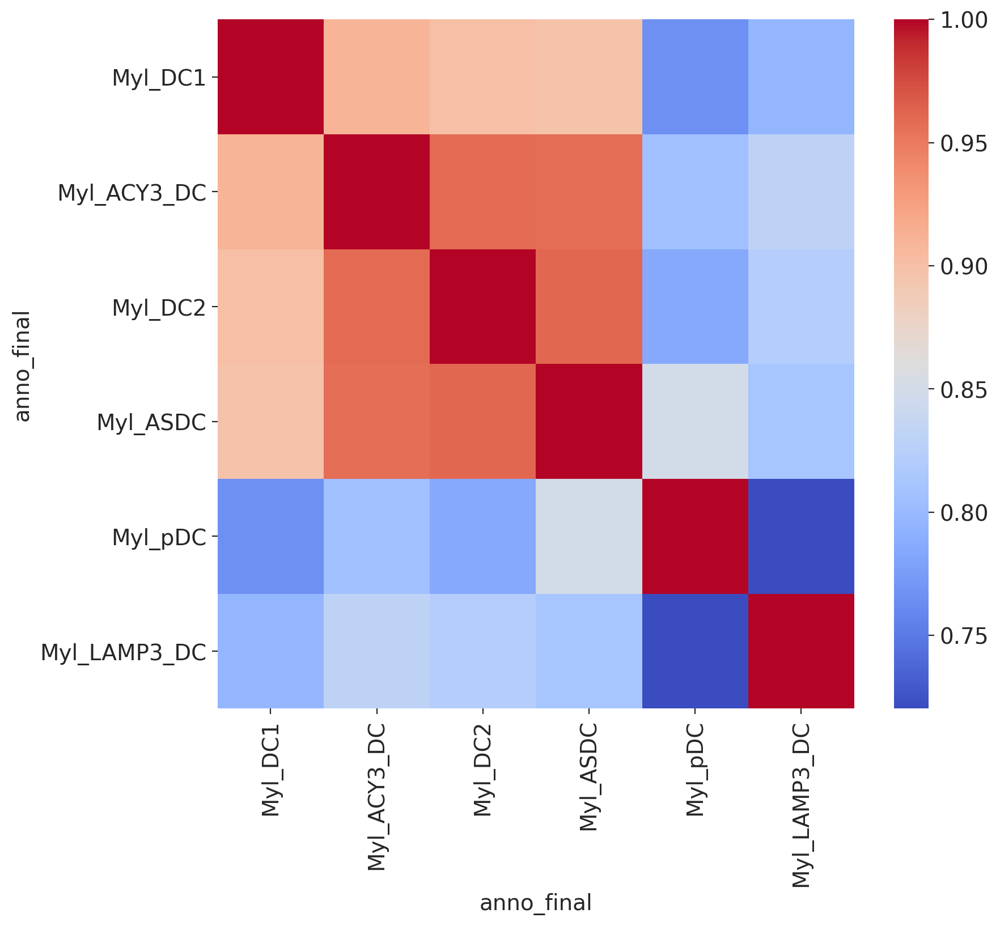

In [113]:
plt.figure(figsize=(9,8))
sns.heatmap(geneexp_slim.T.corr(),cmap='coolwarm')
scjp.save_fig('SF1C.','DC_heatmap',fig_folder='v2_figures')

## tDC Gene Signature

In [427]:
def intersect(a, b):
    return list(set(a) & set(b))

In [428]:
dcdata.obs['ASDC'] = ['ASDC' if 'ASDC' in x else 'DC' for x in dcdata.obs['anno_final']]
volcano = scjp.jhk.sample_volcano(dcdata,patient_id='PatientID',anno_key='ASDC',comp1='ASDC',comp2='DC',quick=True)

Trying to set attribute `.obs` of view, copying.


v2_figures/SF1A.ASDC_signature.pdf


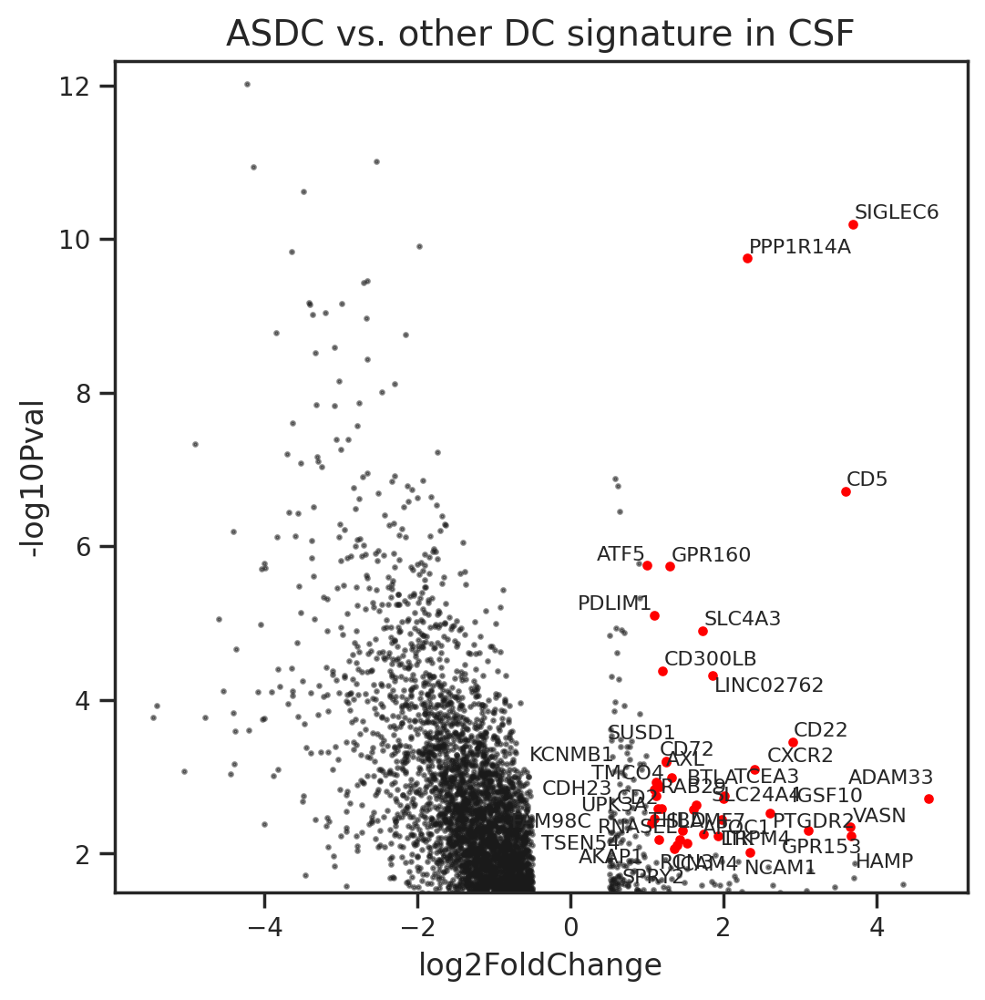

In [433]:
volcano.draw(title='ASDC vs. other DC signature in CSF',sig_mode='pos_pval',pvalue_cut=2.0,show=False)
scjp.save_fig('SF1A.','ASDC_signature',fig_folder='v2_figures')

In [434]:
df = pd.DataFrame([x for x in zip(volcano.genelist,volcano.fc,volcano.pval)],columns=['Gene','Foldchange','pvalue'])
ASDC_genes=df[(df['Foldchange']>0.5) & (df['pvalue']<0.05)].sort_values('pvalue')

v2_figures/SF1A.ACY3_signature.pdf


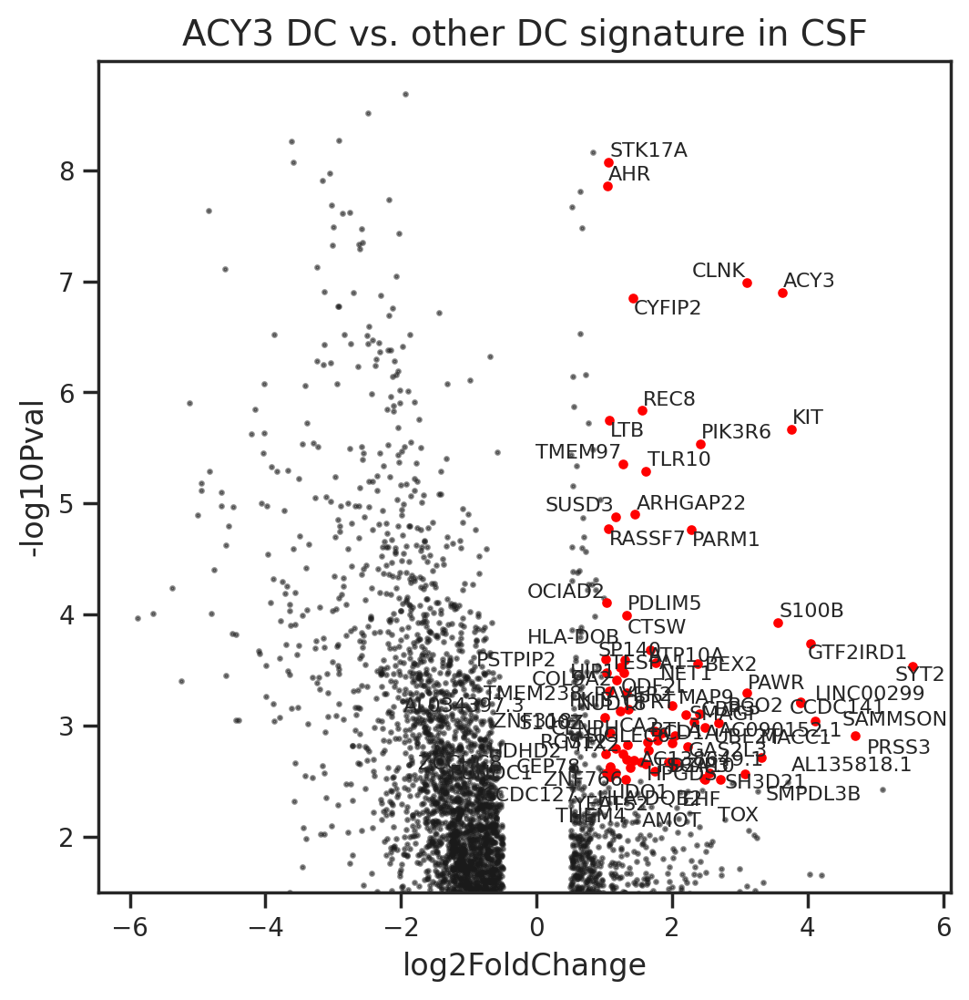

In [436]:
volcano.draw(title='ACY3 DC vs. other DC signature in CSF',sig_mode='pos_pval',pvalue_cut=2.5,show=False)
scjp.save_fig('SF1A.','ACY3_signature',fig_folder='v2_figures')

In [438]:
dcdata.obs['lamp3dc'] = ['LAMP3' if 'LAMP3' in x else 'DC' for x in dcdata.obs['anno_final']]
volcano = scjp.jhk.sample_volcano(dcdata,patient_id='PatientID',anno_key='lamp3dc',comp1='LAMP3',comp2='DC',quick=True)

v2_figures/SF1A.LAMP3_signature.pdf


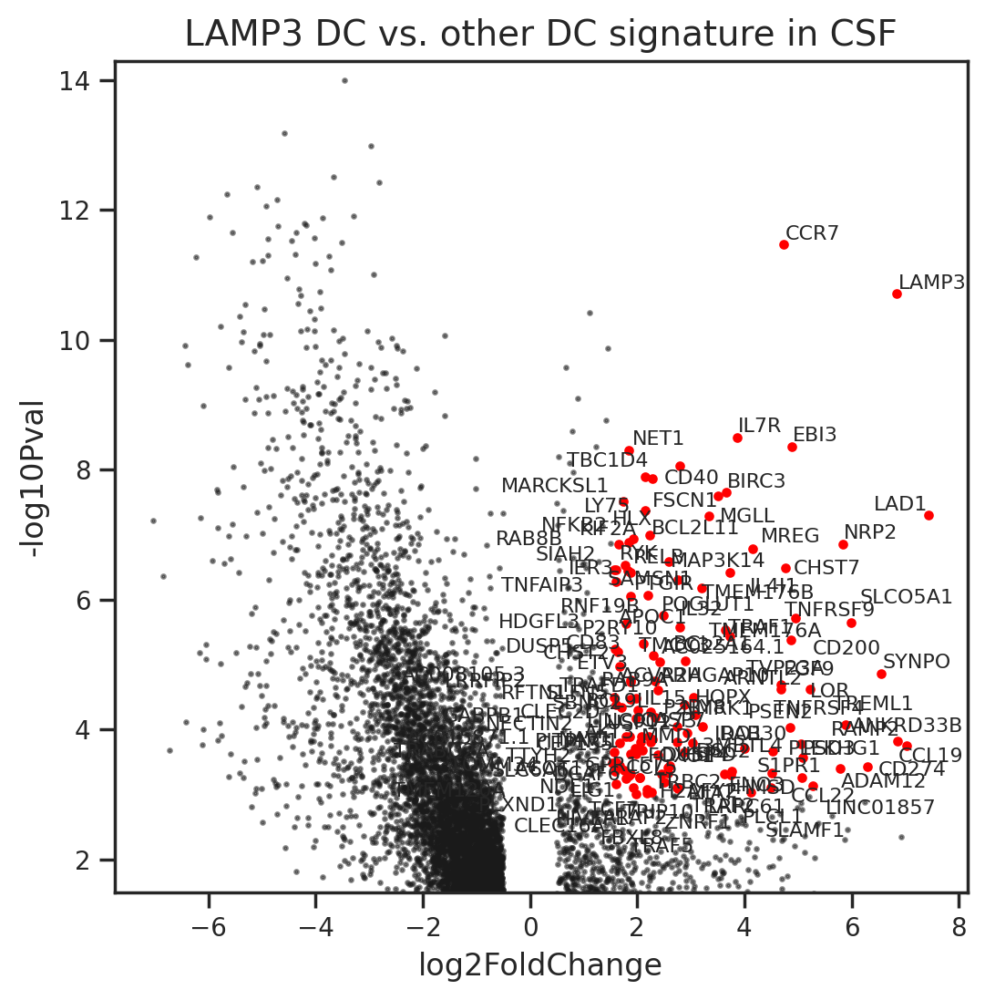

In [442]:
volcano.draw(title='LAMP3 DC vs. other DC signature in CSF',sig_mode='pos_pval',x_pos=1.5,pvalue_cut=3.0,show=False)
scjp.save_fig('SF1A.','LAMP3_signature',fig_folder='v2_figures')

## Cell Interaction Network

In [475]:
ddata = adata[(adata.obs['Tissue']=='CSF') & (adata.obs['Disease']=='Disease')]

### Chemokine & TNF markers

In [476]:
plt.rcParams['xtick.bottom'] = plt.rcParams['xtick.labelbottom'] = True
plt.rcParams['xtick.top'] = plt.rcParams['xtick.labeltop'] = False

In [477]:
cdm_out = scjp.markers.calculate_markers(ddata,'anno_jp_final')

v2_figures/SF2.Dotplot_crosstalk.pdf


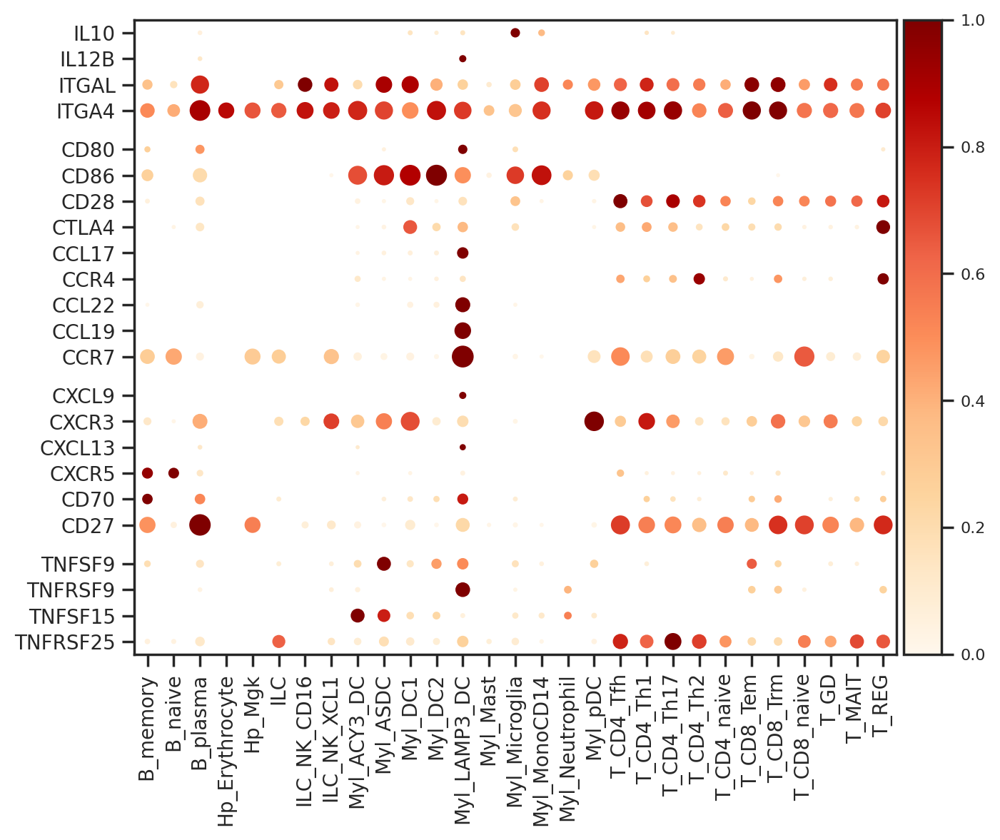

In [479]:
markers='IL10,IL12B,ITGAL,ITGA4, ,CD80,CD86,CD28,CTLA4,CCL17,CCR4,CCL22,CCL19,CCR7, ,CXCL9,CXCR3,CXCL13,CXCR5,CD70,CD27, ,TNFSF9,TNFRSF9,TNFSF15,TNFRSF25'.split(',')
scjp.markers.draw_marker_blob_v2(ddata,cdm_out,markers,show=False)
scjp.save_fig('SF2.','Dotplot_crosstalk',fig_folder='v2_figures')

In [242]:
remain=['B_memory',
 'B_naive',
 'B_plasma',
 'ILC_NK_CD16',
 'ILC_NK_XCL1',
 'Myl_ACY3_DC',
 'Myl_ASDC',
 'Myl_DC1',
 'Myl_DC2',
 'Myl_LAMP3_DC',
 'Myl_pDC',
 'T_CD4_memory',
 'T_CD8_memory',
 'T_REG']

In [302]:
cdm_out = scjp.markers.calculate_markers(ddata[ddata.obs['anno_final'].isin(remain)],'anno_final')

In [467]:
plt.rcParams['xtick.bottom'] = plt.rcParams['xtick.labelbottom'] = False
plt.rcParams['xtick.top'] = plt.rcParams['xtick.labeltop'] = True
from sklearn.preprocessing import MaxAbsScaler

v2_figures/F4.Dotplot_adhesion_slim.pdf


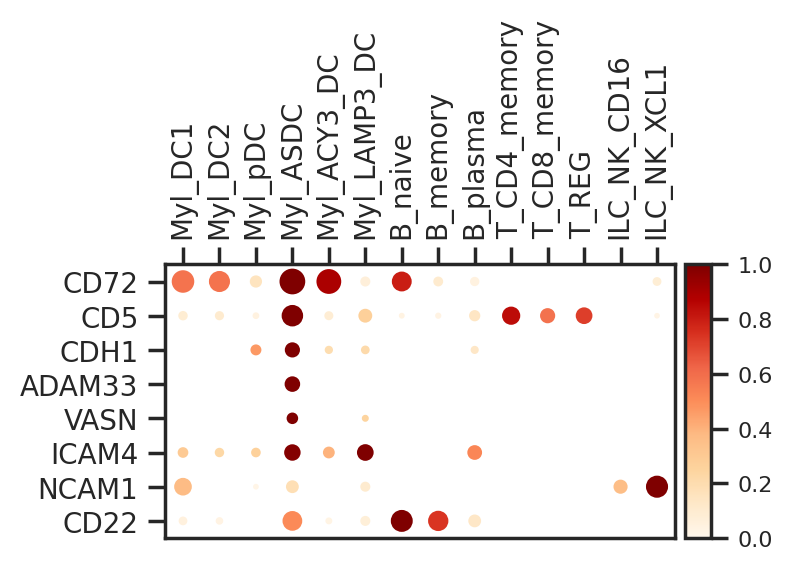

In [310]:
markers='CD72,CD5,CDH1,ADAM33,VASN,ICAM4,NCAM1,CD22'.split(',')
ctlist='Myl_DC1,Myl_DC2,Myl_pDC,Myl_ASDC,Myl_ACY3_DC,Myl_LAMP3_DC,B_naive,B_memory,B_plasma,T_CD4_memory,T_CD8_memory,T_REG,ILC_NK_CD16,ILC_NK_XCL1'.split(',')
scjp.markers.draw_marker_blob_v2(ddata,cdm_out,markers,ctlist=ctlist,show=False)
scjp.save_fig('F4.','Dotplot_adhesion_slim',fig_folder='v2_figures')

In [461]:
mks = scjp.markers.marker(ddata,'anno_final')

Trying to set attribute `.uns` of view, copying.


In [462]:
sdata = ddata
anno_key = 'anno_final'

cts = sorted(set(sdata.uns['cdm_'+anno_key]['mean']))

vstack = []
for ct in cts:
    vstack.append(sdata.uns['cdm_'+anno_key]['mean'][ct])

means = np.vstack(vstack)

In [465]:
col_ord = ['CD5:CD72','CD72:CD5','TNFSF9:TNFRSF9','TNFSF15:TNFRSF25','CCL17:CCR4','CCL22:CCR4',
           'CCL19:CCR7','CXCL13:CXCR5','CD70:CD27','CD80:CD28']

cols = ['Myl_ASDC:B_naive',
        'Myl_ASDC:Myl_ACY3_DC',
        'Myl_ASDC:Myl_ASDC',
        'Myl_ASDC:Myl_LAMP3_DC',
        'Myl_ASDC:T_CD4_memory',
        'Myl_ACY3_DC:T_CD4_memory',
        'Myl_LAMP3_DC:T_REG',
        'Myl_LAMP3_DC:Myl_LAMP3_DC',
        'Myl_LAMP3_DC:B_naive',
        'Myl_LAMP3_DC:B_memory',
        'Myl_LAMP3_DC:B_plasma',
        'Myl_LAMP3_DC:T_CD4_memory'][::-1]

v2_figures/F4B.CPDB_crosstalk.pdf


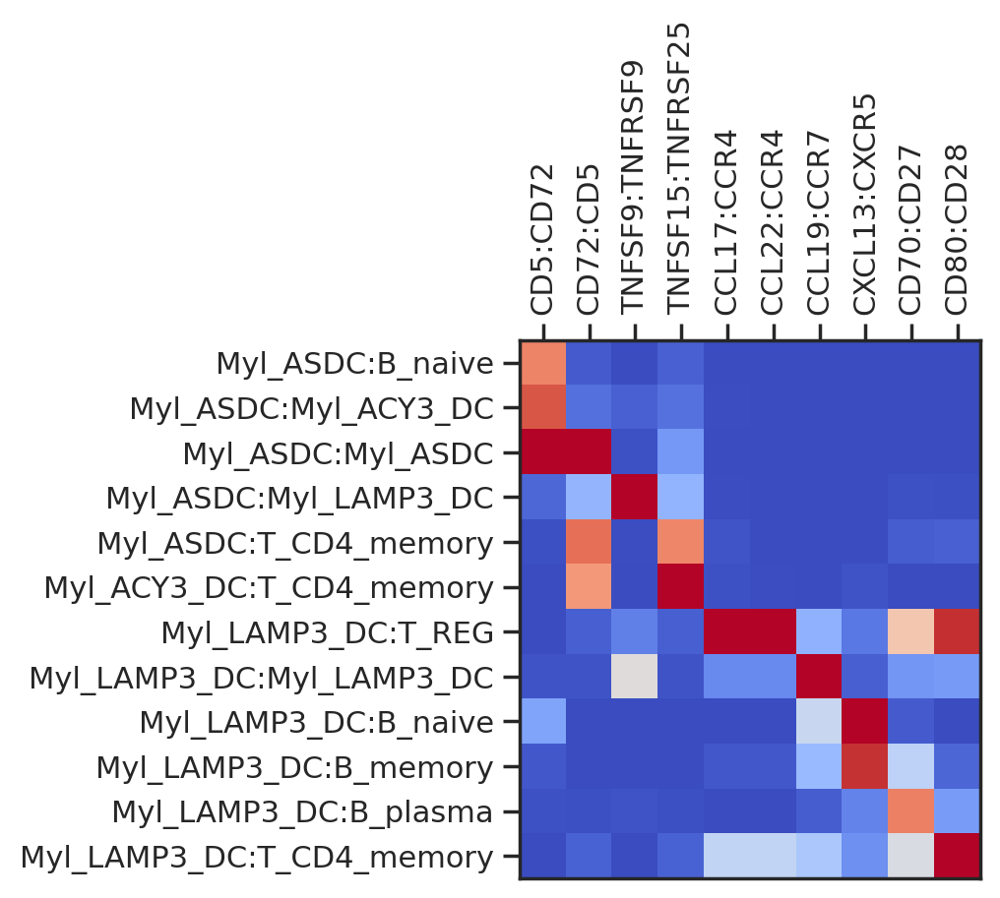

In [468]:
final = np.zeros(shape=(len(col_ord),len(cols)))
for i, x in enumerate(col_ord):
    l = x.split(':')[0]
    r = x.split(':')[1]
    left_idx = sdata.raw.var_names==l
    right_idx = sdata.raw.var_names==r
    j = -1
    
    l_max = np.max(means[:,left_idx])
    r_max = np.max(means[:,right_idx])
    
    for col in cols:
        L = col.split(':')[0]
        R = col.split(':')[1]
        j+=1
        lct_idx = cts.index(L)
        rct_idx = cts.index(R)
        l_mean = means[lct_idx,left_idx]
        r_mean = means[rct_idx,right_idx]
        final[i,j] = (l_mean*r_mean)[0] / (l_max*r_max)

df = pd.DataFrame(MaxAbsScaler().fit_transform(final.T).T)

df = pd.DataFrame(final)

df.index = col_ord
df.columns = cols

xlabel = df.index
ylabel = df.columns

fig,ax = plt.subplots(1, 1,figsize=(len(xlabel)*0.3,len(ylabel)*0.3))

ax.imshow(df.T,origin='lower',extent = [0,len(xlabel),0,len(ylabel)],cmap='coolwarm')

ax.set_xticks(np.linspace(0.5,len(xlabel)-0.5,len(xlabel)))
ax.set_xticklabels(xlabel,rotation=90)
ax.set_yticks(np.linspace(0.5,len(ylabel)-0.5,len(ylabel)))
ax.set_yticklabels(ylabel,rotation=0)
sns.set_style("ticks")
plt.grid(False)
ax.set_aspect('auto')

scjp.save_fig('F4B.','CPDB_crosstalk',fig_folder='v2_figures')
plt.show()

## Trajectory Analysis using PAGA

In [145]:
sc.tl.draw_graph(dccsf, layout='fa')

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:14)


In [146]:
sc.tl.paga(dccsf, groups='anno_final')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])
v2_figures/F3B.PAGA.pdf


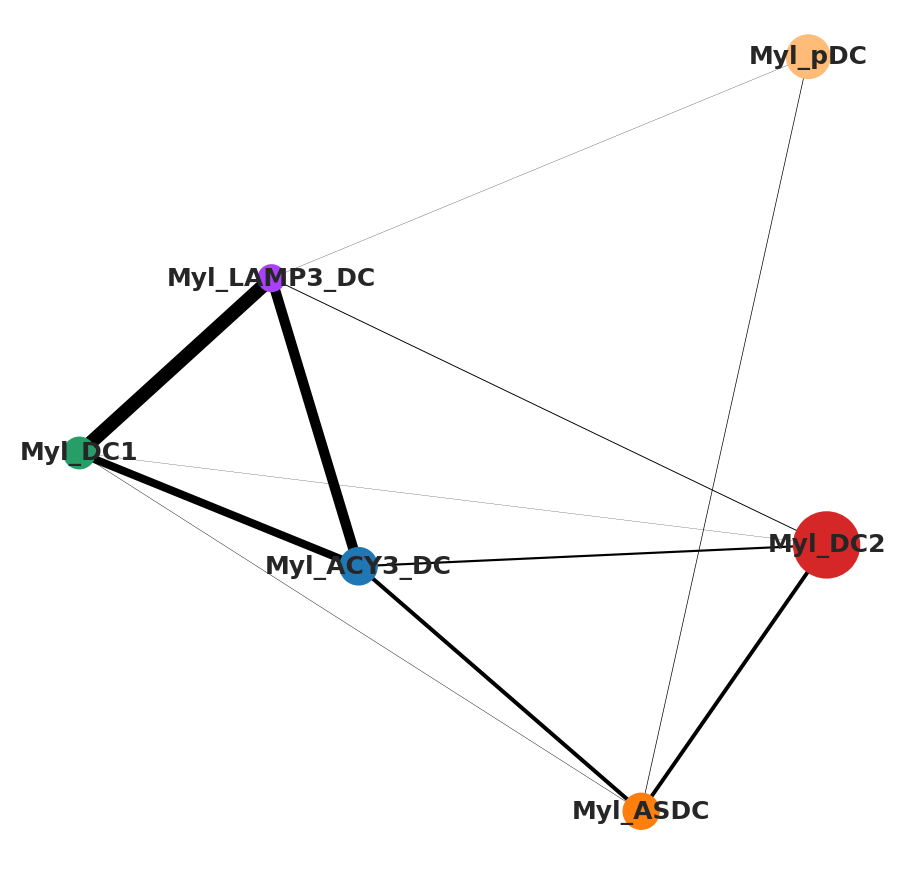

In [147]:
sc.pl.paga(dccsf, color='anno_final',fontsize=9,frameon=False,show=False)
scjp.save_fig('F3B.','PAGA',fig_folder='v2_figures')

## DC2, ASDC, pDC

In [253]:
sub = 'Myl_DC2,Myl_ASDC'.split(',')
dcsub=scjp.get_subset(adata,(adata.obs['Tissue']=='CSF') & (adata.obs['anno_final'].isin(sub)))
scjp.run_harmony(dcsub,'PatientID',n_pcs=10)

extracting highly variable genes
    finished (0:00:01)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
removing cc_genes...
computing PCA
    with n_comps=50
    finished (0:00:19)


2021-12-30 13:00:57,505 - harmonypy - INFO - Iteration 1 of 10
2021-12-30 13:01:01,525 - harmonypy - INFO - Iteration 2 of 10
2021-12-30 13:01:04,041 - harmonypy - INFO - Iteration 3 of 10
2021-12-30 13:01:07,041 - harmonypy - INFO - Iteration 4 of 10
2021-12-30 13:01:09,046 - harmonypy - INFO - Iteration 5 of 10
2021-12-30 13:01:10,437 - harmonypy - INFO - Iteration 6 of 10
2021-12-30 13:01:11,817 - harmonypy - INFO - Iteration 7 of 10
2021-12-30 13:01:13,781 - harmonypy - INFO - Iteration 8 of 10
2021-12-30 13:01:16,549 - harmonypy - INFO - Iteration 9 of 10
2021-12-30 13:01:18,885 - harmonypy - INFO - Iteration 10 of 10
2021-12-30 13:01:21,315 - harmonypy - INFO - Stopped before convergence


calculating neighbors...
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
calculating umap...
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [254]:
sc.tl.draw_graph(dcsub, layout='fa')

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:10)


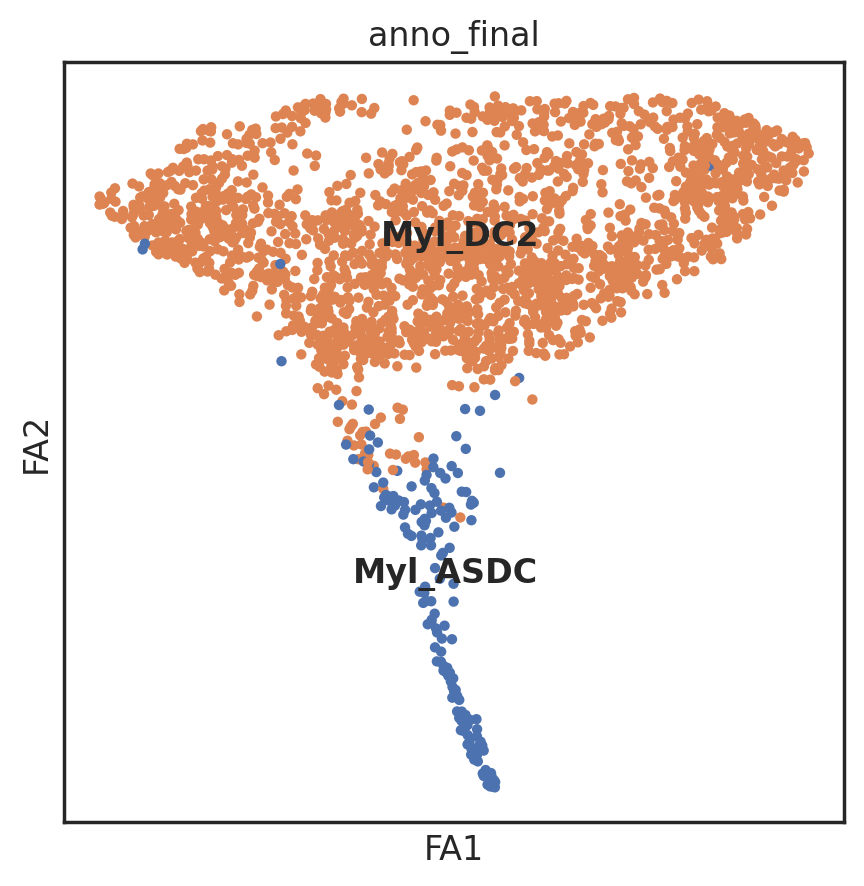

In [255]:
sc.pl.draw_graph(dcsub, color='anno_final', legend_loc='on data')

In [256]:
# Choose a root cell
dcsub.uns['iroot'] = np.flatnonzero(dcsub.obs['anno_final']  == 'Myl_DC2')[0]

In [257]:
sc.tl.dpt(dcsub)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.98860025 0.9743874  0.957227   0.94603294 0.93267506
     0.93001443 0.91986775 0.9100454  0.902846   0.89954484 0.8977271
     0.89063245 0.88002956 0.8797175 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:05)
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


<AxesSubplot:xlabel='FA1', ylabel='FA2'>

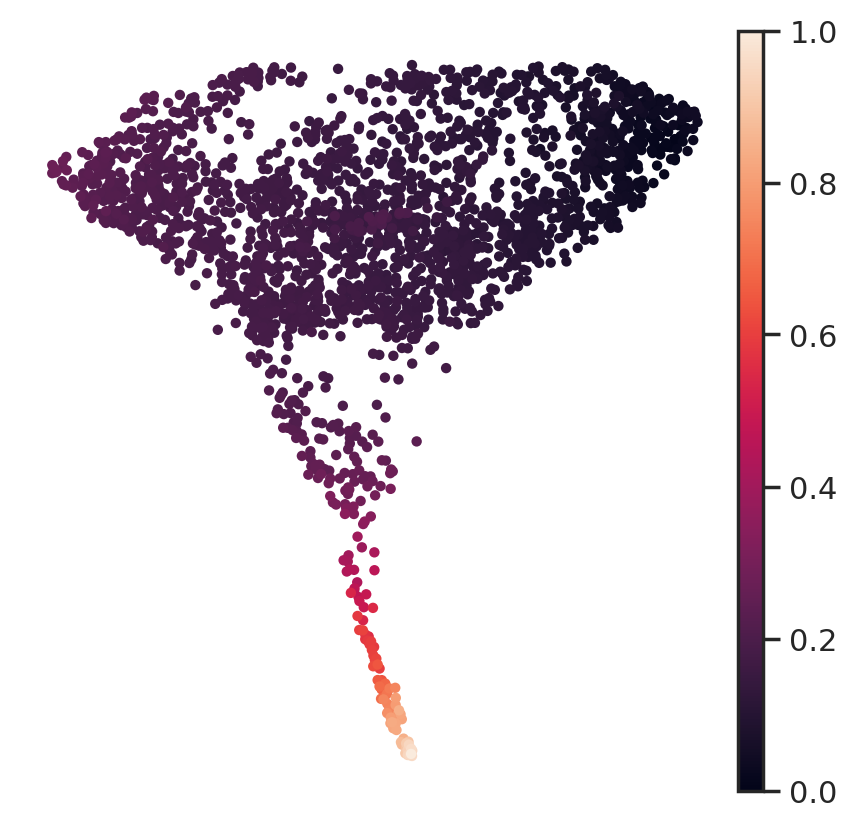

In [258]:
sc.pl.draw_graph(dcsub, color='dpt_pseudotime',frameon=False,title='',show=False)
#scjp.save_fig('SF2.','UMAP_dpt',fig_folder='v2_figures')

In [371]:
def draw_pseudo_heatmap_v2(adata,genelist,anno=None, clist=None, anno_list =None, gridspec_kw = {'height_ratios': [10,1]},figsize=(3,4),fontsize=12, mean_window = 100, anno_window=10):
    
    import sklearn
    def running_mean(x, N):
        cumsum = np.cumsum(np.insert(x, 0, 0)) 
        return (cumsum[N:] - cumsum[:-N]) / float(N)
    
    import numpy as np
    import matplotlib.pyplot as plt
    from matplotlib.colors import LinearSegmentedColormap
    from matplotlib import colors
    
    
    fig,(axes) = plt.subplots(2, 1,  sharex= True,
                        gridspec_kw=gridspec_kw,
                        figsize=figsize)
    
    
    Xt = adata.raw.X
    Rt = Xt.expm1()
    t = adata.obs['dpt_order']
    Rts = Rt[np.argsort(np.array(t))]
    bins = np.linspace(0,len(t),20)
    binlabel = np.digitize(np.array(t), bins)
    adata.obs['dpt_bins'] = [str(x) for x in binlabel]

    gidx = adata.raw.var_names.isin(genelist)
    gene_order = list(adata.raw.var_names[gidx])
    re_order = [gene_order.index(x) for x in genelist]

    normed = sklearn.preprocessing.normalize(Rts[:,gidx][:,re_order].todense().T,norm='max')
    runned = np.apply_along_axis(lambda x: running_mean(x,mean_window),1,normed)
    normed = sklearn.preprocessing.normalize(runned,norm='max')
    

    ax = axes[0]

    height=12
    im = ax.imshow(normed, extent = [0,10,0,height], vmax=1,origin='upper',cmap='RdYlBu_r')
    ax.set_yticks(np.linspace(0,height,len(genelist)+1)[:-1]+height/(len(genelist)*2))
    ax.set_yticklabels(genelist[::-1],fontsize=fontsize)
    ax.set_xticks([])
    ax.grid(False)
    ax.set_aspect('auto')
    
    if anno:

        anl = sorted(list(set(adata.obs[anno])))
        Ob = np.vstack([np.array(adata.obs[anno]==an) for an in anl]).astype(int).T
        Obs = Ob[np.argsort(np.array(t))]

        order = anl
        if anno_list!=None:
            re_order = [anl.index(x) for x in anno_list]
        else:
            re_order = [anl.index(x) for x in anl]
            anno_list = anl

        normed = sklearn.preprocessing.normalize(Obs[:,re_order].T,norm='max')
        runned = np.apply_along_axis(lambda x: running_mean(x,anno_window),1,normed)
        normed = sklearn.preprocessing.normalize(runned,norm='max')
        normed = normed>0
        ax = axes[1]
        
        height=1.4


        if clist:
            clist = ['white']+clist
        else:
            clist = ['white']+list(np.array(adata.uns[anno+"_colors"])[re_order])

        for i in range(len(anl)):
            print(i, height/len(anl)*i,height/len(anl)*(i+1), anno_list[i])
            cmap = colors.ListedColormap([clist[0],clist[i+1]])
            ax.imshow(normed[i:i+1], extent = [0,10,height/(len(anl))*i,height/(len(anl))*(i+1)], vmax=1,origin='upper',cmap=cmap)
        ax.set_yticks(np.linspace(0,height,len(anno_list)+1)[:-1]+height/(len(anno_list)*2))
        ax.set_yticklabels(anno_list,fontsize=fontsize)
        ax.set_xticks([])
        ax.set_ylim(0,height)
        ax.grid(False)
        ax.set_aspect('auto')

    plt.subplots_adjust(wspace=0, hspace=0.01)
    
    return im

In [367]:
dcsub.obs['dpt_order'] = dcsub.obs['dpt_pseudotime']

In [368]:
temp=dcsub[dcsub.obs['dpt_order']>0.2]

In [369]:
anno='anno_final'
anno_order = ['Myl_DC2','Myl_ASDC'][::-1]

0 0.0 0.5 Myl_ASDC
1 0.5 1.0 Myl_DC2
v2_figures/F3.Pseudotime_heatmap.pdf


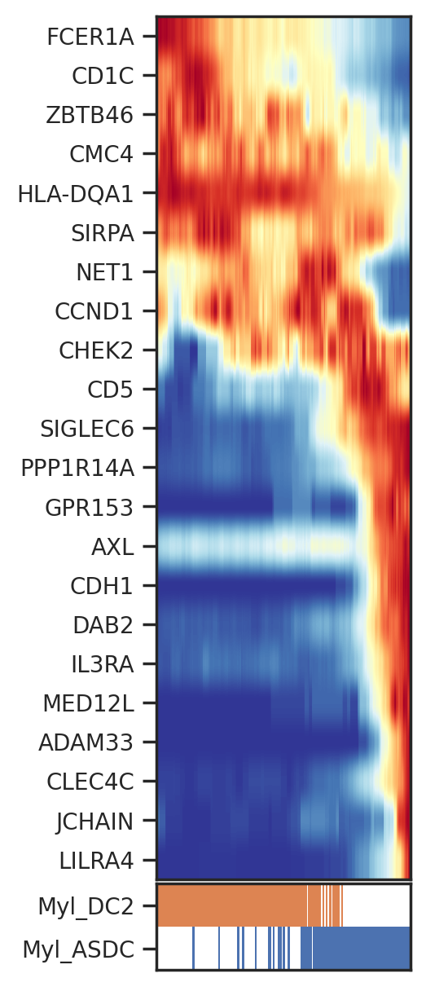

In [373]:
gene_list='FCER1A,CD1C,ZBTB46,CMC4,HLA-DQA1,SIRPA,NET1,CCND1,CHEK2,CD5,SIGLEC6,PPP1R14A,GPR153,AXL,CDH1,DAB2,IL3RA,MED12L,ADAM33,CLEC4C,JCHAIN,LILRA4'.split(',')
im = draw_pseudo_heatmap_v2(temp,gene_list,anno=anno,
                                 anno_list = anno_order,figsize=(2,0.35*len(gene_list)),
                                 gridspec_kw={'height_ratios':[10,1]},fontsize=10,
                                 anno_window=3,mean_window=50)
scjp.save_fig('F3.','Pseudotime_heatmap',fig_folder='v2_figures')

## CellProp

In [225]:
color_total1={a:b for a,b in zip (sorted(set(adata.obs['anno_jp_final'])),adata.uns['anno_jp_final_colors'])}

In [227]:
from scipy.stats import ttest_ind, mannwhitneyu
def celltypedf(ref_df,compare,comp_key,subset=None,subset_key=None):
    df = pd.DataFrame(index=cell_list)
    pval = {}
    fc = {}
    for i,f in enumerate(cell_list):
        temp = ref_df[ref_df['anno_jp_final']==f]
        if subset:
            temp = temp[temp[subset]==subset_key]
        pval[f]=mannwhitneyu(temp[temp[compare]==comp_key]['value'],temp[temp[compare]!=comp_key]['value'])[1]
        fc[f]=(np.mean(temp[temp[compare]==comp_key]['value'])+0.0001)/(np.mean(temp[temp[compare]!=comp_key]['value'])+0.0001)
    df['fold_change'] = [fc[x] for x in df.index]
    df['pvalue'] = [pval[x] for x in df.index]
    df['colors'] = [color_total1[x] for x in df.index]
    df = df.sort_values('fold_change',ascending=True)
    return df

In [400]:
def celltypedotplot(df,title,legend=False,xlim=6,ylim=5.5,xtext=0.3,ytext=0.15):
    for index, row in df.iterrows():
        if row['pvalue']==0: row['pvalue']=1e-5
        plt.scatter(np.log2(row['fold_change']),-np.log10(row['pvalue']),edgecolors='dimgray',
                   color=row['colors'],label=index,s=120)
        if legend==True:
            plt.legend(bbox_to_anchor=(1.1, 0.5),loc='center left', borderaxespad=0,fontsize=8)
        if (-np.log10(row['pvalue'])>1.0):
            plt.text(np.log2(row['fold_change'])-xtext,-np.log10(row['pvalue'])+ytext,index,color=row['colors'],fontsize=10)       
        if (np.log10(row['pvalue'])>1.0):
            plt.text(np.log2(row['fold_change'])-xtext,-np.log10(row['pvalue'])+ytext,index,color=row['colors'],fontsize=10)      
    plt.xlim(-xlim,xlim)    
    plt.ylim(-0.1,ylim)
    plt.axhline(y=1, color='blue', linestyle='--',zorder=-16)
    plt.axvline(x=0, color='midnightblue',alpha=0.7,zorder=-15)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.xlabel('log2 Fold Change', fontsize=15)
    plt.ylabel('-log10 p-value', fontsize=15)
    plt.axhline(y=1.3, color='red', linestyle='--',zorder=-16)
    plt.title(title,fontsize=15)
    plt.grid(False)
    sns.set_style("ticks")

In [388]:
cell_list = sorted(list(set(adata.obs['anno_jp_final'])))
DiseaseCode = {i:z for i,z in zip(adata.obs.Sample,adata.obs.DiseaseCode)}
Disease = {i:z for i,z in zip(adata.obs.Sample,adata.obs.Disease)}
PatientID = {i:z for i,z in zip(adata.obs.Sample,adata.obs.PatientID)}
Source = {i:z for i,z in zip(adata.obs.Sample,adata.obs.Source)}
Tissue = {i:z for i,z in zip(adata.obs.Sample,adata.obs.Tissue)}

In [389]:
prop = pd.crosstab(adata.obs['Sample'], adata.obs['anno_jp_final'], normalize=0)
a_df = prop.reset_index().melt(id_vars='Sample')
a_df['DiseaseCode'] = [DiseaseCode[x] for x in a_df['Sample']]
a_df['DiseaseCode'] = ['NMOSD' if 'NMOSD' in x else x for x in a_df['DiseaseCode']]
a_df['Disease'] = [Disease[x] for x in a_df['Sample']]
a_df['PatientID'] = [PatientID[x] for x in a_df['Sample']]
a_df['Source'] = [Source[x] for x in a_df['Sample']]
a_df['Tissue'] = [Tissue[x] for x in a_df['Sample']]

v2_figures/SF1.CTvolcano_CSFPBMC.pdf


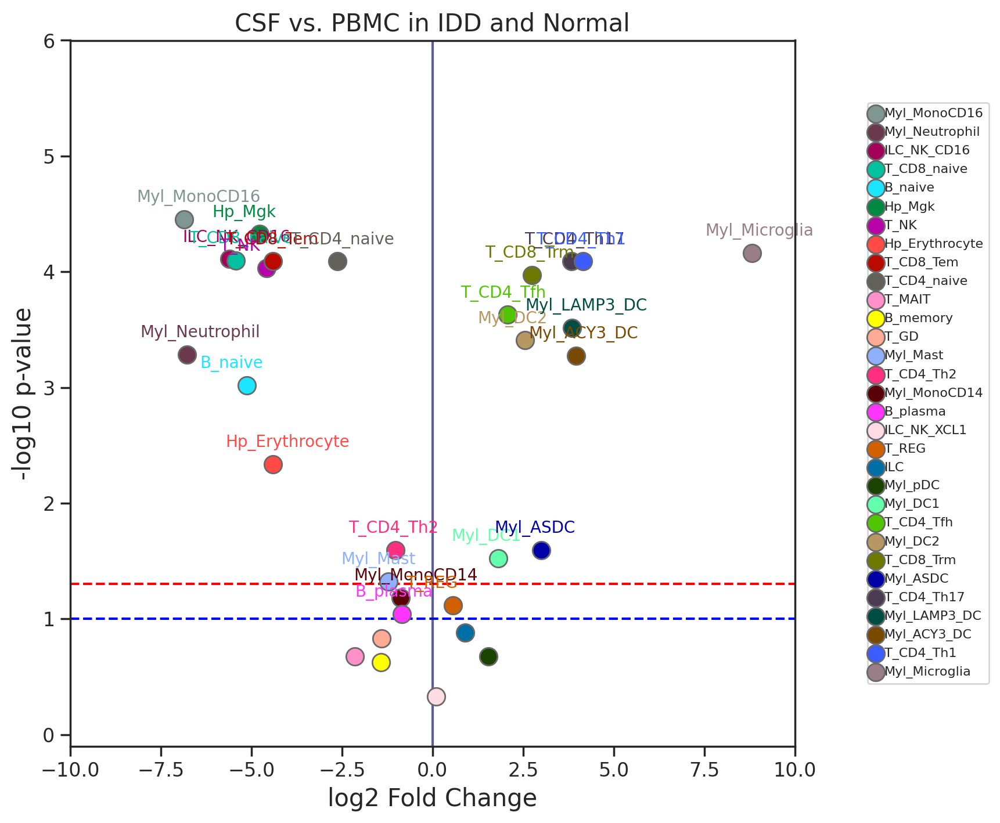

In [401]:
title='CSF vs. PBMC in IDD and Normal'
df = celltypedf(a_df,compare='Tissue',comp_key='CSF')
plt.figure(figsize=(8,8))
celltypedotplot(df,title,legend=True,xlim=10,ylim=6,xtext=1.3,ytext=0.15)
scjp.save_fig('SF1.','CTvolcano_CSFPBMC',fig_folder='v2_figures')

v2_figures/SF1.CTvolcano_DzNor.pdf


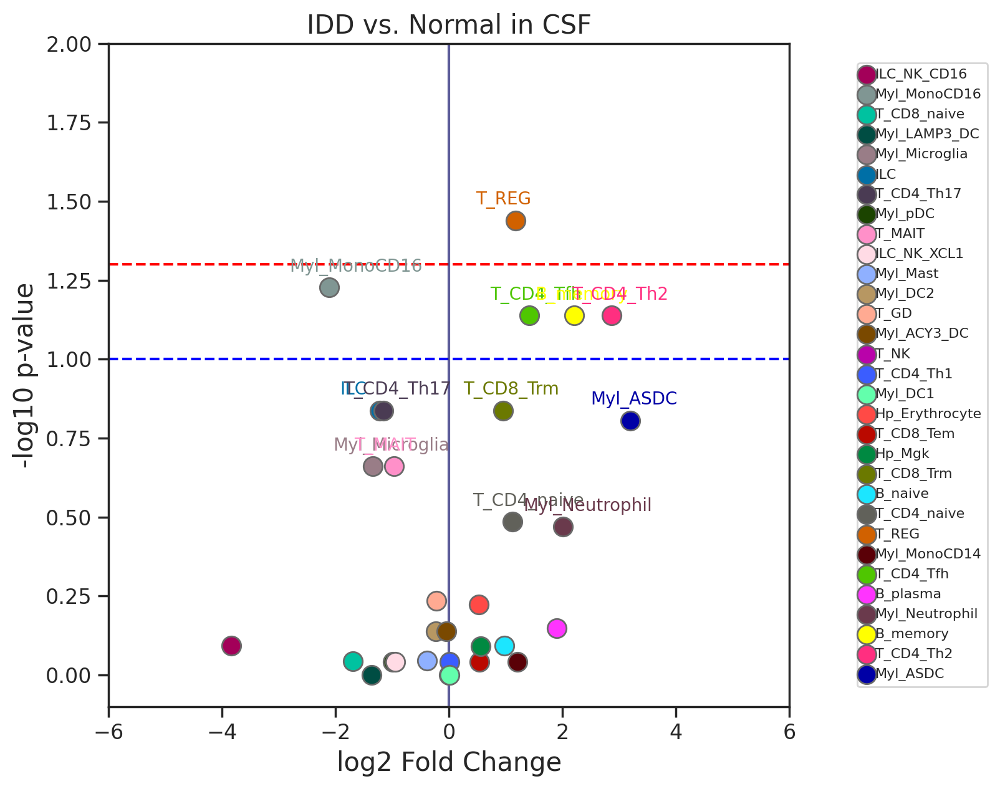

In [399]:
title='IDD vs. Normal in CSF'
df = celltypedf(a_df,compare='Disease',comp_key='Disease',subset='Tissue',subset_key='CSF')
plt.figure(figsize=(7,7))
celltypedotplot(df,title,legend=True,ylim=2,xtext=0.7,ytext=0.05)
scjp.save_fig('SF1.','CTvolcano_DzNor',fig_folder='v2_figures')